In [127]:
from PIL import Image



import math
import itertools
import cmath
import pandas as pd
import numpy as np
np.random.seed(42)
rng = np.random.default_rng(42)

from scipy import linalg as la

#------ Sklearn ------#
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.preprocessing import LabelEncoder


#------ Plots --------#
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from matplotlib import pyplot as plt
import seaborn as sns

LINE = go.scatter.Line(width=1)
DOT_LINE = lambda color: go.scatter.Line(width=1, dash='dot', color=color)
MARKER = go.scatter.Marker(size=6)

TEXT_ANNOTATION = lambda x,y,text: go.layout.Annotation(
            x=x,
            y=y,
            xref="x",
            yref="y",
            text=text,
            showarrow=False,
            )

ARROW_ANNOTATION = lambda x,y,text: go.layout.Annotation(
            x=x,
            y=y,
            xref="x",
            yref="y",
            text=text,
            showarrow=True,
            arrowsize=2
            )

SLIDER_STEP = lambda name, label: {'args': [
                                        [name],
                                        {
                                            'frame': {
                                                'duration': 80, 'redraw': False},
                                                'mode': 'immediate',
                                                'transition': {'duration': 80}
                                        }
                                    ],
                            'label': label,
                            'method': 'animate'
                           }

AXE = lambda x,y,name,color:   {
                                'type': 'line',
                                'name': name,
                                'x0': x,
                                'y0': y,
                                'x1': -x,
                                'y1': -y,
                                'line': {
                                    'color': color,
                                    'width': 1,
                                    'dash':'dot'
                                }
                              }


DEFAULT_PLOTLY_COLORS = [
    '#1f77b4',  # muted blue
    '#ff7f0e',  # safety orange
    '#2ca02c',  # cooked asparagus green
    '#d62728',  # brick red
    '#9467bd',  # muted purple
    '#8c564b',  # chestnut brown
    '#e377c2',  # raspberry yogurt pink
    '#7f7f7f',  # middle gray
    '#bcbd22',  # curry yellow-green
    '#17becf'   # blue-teal
]

In [126]:
%%html
<h1>
Mathematics in Machine Learning
</h1>

''
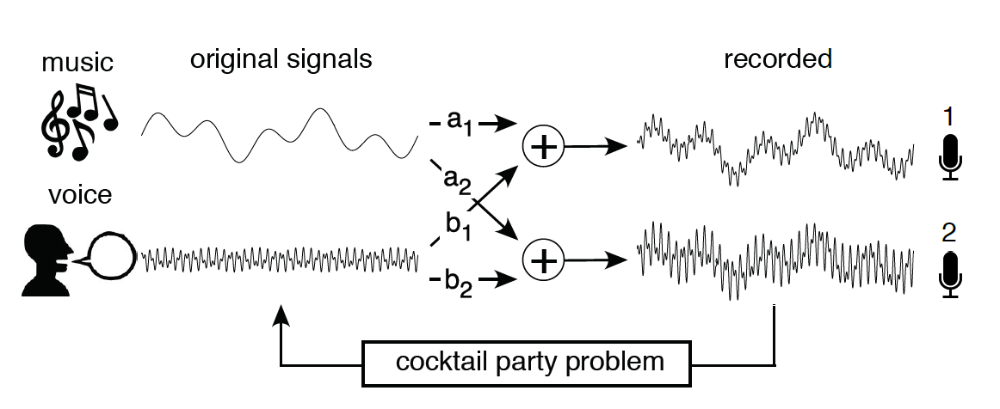

In [149]:
import base64, io, IPython
from PIL import Image as PILImage

image = PILImage.open('images/cocktail_party_problem.png')

output = io.BytesIO()
image.save(output, format='PNG')
encoded_string = base64.b64encode(output.getvalue()).decode()

html = '<img align="center" src="data:image/png;base64,{}"/>'.format(encoded_string)
html

# Introduction

## Why does make sense to do Machine Learning?
Machine learning is the study of computer algorithms, with the aim of generating models, called **learners** *able to make predictions or decisions without being explicitly programmed to do so*.

At the base of machine learning there is a whole statistical learning framework that explains the structure of the learning paradigm in terms of a *data-generation model* and a *measure of success (or loss)* and defines the learning activity as the maximization of this success (or equivalently, minimization of the loss).

*Empirical risk minimization (ERM)* is a principle in statistical learning theory which defines a family of learning algorithms and is used to give theoretical bounds on their performance. 
These bounds are given in statistical terms considering two term of randomness: first an *approximation* term that tells us the goodness of the learner and second a *probabilistic* term that give the probability that the learner will be a good learner. Based on the constraints that we ...

- PAC learnability:
- Agnostic PAC learnability
- Uniform learnability
- Non-Uniform learnability

## Why do we need datascientists?
The theory tells us that is not crazy thinking at an algorithm able to learn structure of the data and to generalize them to broader fields.
So, the following question one is naturally inclined to ask is: if we have guarantees that a learner is able to learn, why do we need data scientists?

Paraphrasing a celebre quote from Ron Weber, if it's too good to be true...probably it is.
Unfortunately (or fortunately, depends on the points of view) the same exact theory tells us that we can't imagine any behavior remotely close to human intelligence, withouth some human intelligence backup.

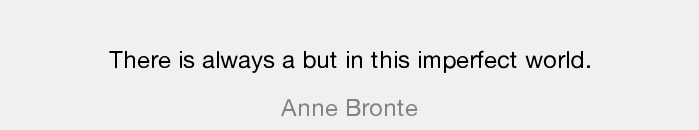

A fundamental point of PAC theory is the so called *inductive bias*. To make sure everything runs smoothly, we need to inject some prior knowledge into the framework. This knowledge in the PAC scheme is coded in terms of *constraints to the hypothesis set* (or type of learners) we decide to adopt to tackle a given problem.


### No free Lunch Theorem
The theory tells us that a class of hypothesis is PAC learnable if for any problem we can find a number of examples that we should feed to him that guarantees that it is able (proably and aproximately) to learn the problem. The key point is that to have these guarantees we need to introduce some bias, restricing a priori the set of algorithm we decide to use.

> Is it really necessary to have prior knowledge on the problem?

We can ask ourselfes if there exist an algorithm $\mathcal A$ and a training set size $m$, such that for every distribution $\mathcal D$, if $\mathcal A$  receives $m$ i.i.d. examples from $\mathcal D$, there is a high chance it outputs a predictor h that has a low risk. An algorithm of this type is said to be a **universal learner**.

The "no free lunch" was formalized by David Wolpert and William Macready in the 1997 [1]. The No-Free-Lunch theorem states that no such universal learner exists. To be more precise, the theorem states that for binary classification prediction tasks, for every learner there exists a distribution on which it fails, even though that distribution can be successfully learned by another learner.

This means that it's impossible to find a learner able to succesfully tackle every task, and it's a human problem decide which algorithm is the most suited for the given problem.

### Curse of dimensionality
That's not all! In the feature space each variable is a dimension. Real data can have thousand of dimension. Consider for example images or text-documents where the dimensionality is given by the vocabulary of words.

These high-dimensional spaces involves having to deal with other problems. Some of these problems are computational related due to the fact that is computational expensive to treat high dimensional points; other are related to intrisic properties of these mathematical spaces.

> Points in hidh dimensional spaces are isolated

The **curse of dimensionality** is an expression coined by Richard Bellman, to refer to phenomenon that arise when analyzing and organizing data in high-dimensional space. 

In the feature space $\mathcal X$ each variable represent a dimension. As variables get added, data space becomes very sparse. This practically means that **high dimensional spaces are almost empty**.

There are different approches to show this beahvior. Assume your data lives in the space $[0, 1]^p$, that is the unitary hypercube in the $p$-space. To capture a neighborhood which represents a fraction $s$ of the hypercube volume, you need the edge length to be $s^{1/p}$, such that $(s^{1/p})^p=s$:


In [15]:
percentages=np.linspace(0,1,101)
n_dims = [1,2,3,5,10,50, 100, 1000]
ten_percent = []
fig = go.Figure()

for p in n_dims:
    s = percentages ** (1/p)
    ten_percent.append(s[10])
    fig.add_trace(go.Scatter(x=percentages, y=s, mode='lines', line=LINE, marker=MARKER, name=p))

fig.add_trace(go.Scatter(x=[0.1]*(len(ten_percent)+2), y=[-100]+ten_percent+[100],
                         name='10 %', mode='lines+markers+text',
                         text=ten_percent,textfont=dict(size=9,color='black'), 
                         texttemplate="edge: %{y:.3f}", textposition='middle right', 
                         marker=dict(color='gray'),line={'width':1,'dash':'dot'},
                        )
             )
fig.update_layout(
    xaxis=(dict(range=[-0.02, 0.6],title='% Volume')), 
    yaxis=(dict(range=[-0.05, 1.05],title='Edge length')), 
    height=600,
    legend_title = 'Dimension:',
    title="Edge of hypercube needed to cover % of volume of unitary hypercube in different dimensions"
)
fig.show()

As we can see from the graph, this value rapidly explode for growing values of $p$. For example to capture the 10% of the volume of an 10D-hypercube, you need a 10D hypercube of segment $s = 0.1^{1/10} \simeq 0.8$. In other words in an hypercube of edge 0.8 is contained only the 10% of the information of the entire unitary 10D hypercube. This means that *the hypercube is practically empty*. 

<img src='images/alien.jpg' width=600>

Note that also the contrary is valid. Considering a $p$-hypercube with and edge length of $r=0.1$ we have that its volumes is $0.1^p$. When $p$ grows, the volume quickly becomes so small that the probability to caputre points from your neighborhood becomes very small.

Consider $X,Y$ two independents variables, with uniform on $[0,1]^p$. It can be proved that the mean squared distance $\|X-Y\|^2 satisfies:

$$ \mathbb E \big[\|X-Y\|^2\big] = p/6,\qquad std\big[\|X-Y\|^2\big] \simeq 0.2\sqrt p $$

In [16]:
a = np.array([2, 4, 10, 25, 50, 100,500, 1000])

    
fig = go.Figure()
fig.add_trace( go.Scatter(y = a/6, x=0.2*np.sqrt(a), line_shape='spline', mode='lines+markers+text',
              text=[f"$\mu= {x/6:.2f}, \sigma\simeq {0.2*np.sqrt(x):.2f}$" for x in a],
              textposition = 'bottom right',
                ))
             
fig.update_layout(title='Log/Log plot of mean/std distance between 100 points',
            yaxis=dict(title=f"$\log\mathbb E[\|X-Y\|^2]$", scaleanchor = "x",scaleratio = 1,type='log'), 
            xaxis=dict( title=f'$\log std[\|X-Y\|^2] $',type='log'), height=500)

We can analize the beahvior for different values of p. From a log-log plot we can clearly see a linear trend between the two varibles. This means that the expected valued of the mean squared distance grows exponentially with respect to the standard deviation. This means that for growing p, the average distance will increase very fast while the difference between the distances will be negliceble

> In high dimension the notion of distance will lose meaning

To show better this comportment we can draw 100 points uniformely from a $p$ unitary hypercube and plot the normalized distribution of the distances

In [4]:

n_dims = [2, 4, 10, 25, 50, 100,500, 1000]
n_samples = 100

df_distances = pd.DataFrame(columns=['distance', 'n_dim'], dtype=int)
stds = []

for p in n_dims:
    points = np.random.rand(n_samples, p) 
    dist = euclidean_distances(points).flatten()
    
    dist = dist[dist > 0] / max(dist)
    stds.append(dist.std())
    df_temp = pd.DataFrame({'n_dim':np.full(len(dist), p, dtype=np.int32), 'distance':dist})
    df_distances = df_distances.append(df_temp, ignore_index=True)

fig = px.histogram(df_distances,nbins=500,animation_frame = 'n_dim', labels={'n_dim':'number of dimensions', 'value':'euclidean distance / max(distance)'})

for i, frame in enumerate(fig.frames):
    frame.layout['annotations'] = [TEXT_ANNOTATION(0.2, 130, f"$std \simeq {stds[i]:.2f}$")]
        
for step in fig.layout.sliders[0].steps:
    step["args"][1]["frame"]["redraw"] = True

fig.update_layout(xaxis={'matches':None}, yaxis={'range':[0,150]}, showlegend=False,title='Normalized distribution of distances among 100 points')
fig.show()

### The role of the datascientist
This statistical framework gives us guarantees on the learning activity, but it also show us that is fundamental to introduce some *human intelligence* in this framework in order to make it work. 

It is exactly here, where the *data scientist* comes in, injecting the intelligent part in the system. The data scientist is a sort data craftsman. Its work is to ***prepare the framework in order to make it work correclty.***

This preparation is done thorugh a whole data-preparation pipeline, in which only last is the choice of correct algorithm. 

Before this, in the first phases of the pipeline, there is process of exploration and preparation of the data. In this phases tipically, through data exploration techniques we aim to gather information on the features space $\mathcal X$ we are dealing with and then we try exploit these information to modify the original space to better fit our needs.

This second step is called *preproccessing*. This generally is the most crucial phase of the entire pipeline. A good preprocessing in fact, allow us to bring out the main characteristics of the data we are dealing with, helping in the choice and correct functioning of the final algorithm.


# PCA
Principal Component Analysis is probably the most famous and one of the oldest multivariate statistical technique. It was originally proposed by Karl Pearson in the 1907, but its current embodiement it's due to the work of Hotellyng, that in 1933 formalized the idea and firstly introduced the term *principal component*.

Basically principal component analysis (PCA) is an orthogonal linear transformation that maps the original data onto a *new coordinate system*. The idea at the base of PCA is to find an orthogonal set of vectors that spans the original space where the data are located. These vectors are not chosen randomly but are the ones that carry *the most information possible* of the original set. The information present in the data is considered in terms of variance. Hence, the vectors of the orthogonal basis are **directions of maximum variance of the data**. These vectors are called **principal components** and are constructed as a *linear combination of the basis of the original features space*. Moreover these vectors are ordered by importance, such that the first component is required to have the largest possible variance (the most information possible). The second component is the second for information carried and it's orthogonal to the first one, and so on.

<div class="quote">
  <blockquote>
PCA aims to find the most accurate data representation in a lower dimensional space
  </blockquote>
</div>

The idea of PCA is to find the *most accurate representation of the initial data in a lower dimensional space*. So for example if we map our original $n$-dimensional points into a 2D-plane composed by the first two principal components, we want that this projection is *the best possible 2D representation of our original points*. In this optic we can define the principal components as the ordered set of vectors that **minimize the orthogonal projection error**.

In [122]:
# Generate points
points = np.random.multivariate_normal((0,0), [[6, 3], [3, 6]], size=30)

frames = []
steps=  []
k = 8

pc1 = PCA().fit(points).components_[0]
pc1_phase = cmath.polar(complex(pc1[0], pc1[1]))[1]


for i,angle in enumerate(np.linspace(0,cmath.pi, 33)):
    
    # Computing projector
    u = cmath.rect(1.0, pc1_phase + angle)
    u = np.array([u.real, u.imag])
    projector_u = u[:,np.newaxis].dot(u[np.newaxis, :])/np.linalg.norm(u)
    
    # Projecting points
    projected_points = points @ projector_u
    rss = mean_squared_error(points, projected_points)
    
    # Extracting points for scatter plot
    final_points_x = np.array([(f_x, i_x, None) for i_x, f_x in zip(points[:,0], projected_points[:,0])]).flatten()
    final_points_y = np.array([(f_y, i_y,  None) for i_y, f_y in zip(points[:,1], projected_points[:,1])]).flatten()
    mask = np.array([('white', 'blue', 'yellow') for i_y, f_y in zip(points[:,1], projected_points[:,1])]).flatten()
    

    
    scatter = go.Scatter(x=final_points_x, y=final_points_y, mode='lines+markers',
                         marker=dict(size=8,color=mask, line=dict(width=1,color='grey')),
                         line=dict(color='crimson', width=0.7)
                        )

    # Preparing Frame
    frame = go.Frame(data = scatter, 
                     name=f'{angle:.2f}',
                     layout=go.Layout(annotations=[
                                 TEXT_ANNOTATION(-5,5,"$RSS = \sum_{i\in X}\|x_i - ux_i\|^2 = "+f"{rss:.2f}$",),
#                                  TEXT_ANNOTATION(-7,8,f"${(i/k):.2f}/{64//k} \pi$",)
                             ],
                                      shapes = [
                                          AXE(pc1[0]*10000,pc1[1]*10000,'pc1', 'rgb(55, 128, 191)'),
                                          AXE(u[0]*10000,u[1]*10000, 'rotation_axe', 'rgb(155, 128, 191)')
                                          ]
                                     )
                          )
    
    
    
    if i%k==0:
        slider_step = SLIDER_STEP(f'{angle:.2f}', 
                                  f'{i//k}/{32//k}π' if i != 0 and i != 32 else f'{i//32}π')
    else:
        slider_step = SLIDER_STEP(f'{angle:.2f}', f'')
    steps.append(slider_step)
    frames.append(frame)


fig = go.Figure(
    data= go.Scatter(x=points[:,0], y=points[:,1], mode='markers'),
    layout=go.Layout(
        xaxis=dict(range=[-8,8], autorange=False),
        yaxis=dict(range=[-8,8]),
        title="Residual Sum of Squares",
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None, {"frame": {"duration": 80, "redraw": False},}]
                          )])],
        
        shapes = [AXE(pc1[0]*1000,pc1[1]*1000,'pc1', 'rgb(55, 128, 191)')]
    ),
    frames=frames
)


# Create and add slider
sliders = [dict(active=0, pad={"t": 50}, steps=steps)]
fig.update_layout(sliders=sliders, yaxis=dict( scaleanchor = "x",scaleratio=1), height=700)
fig.show()


Consider a dataset $X\in\mathbb R^{m, n}$, where $m$ is the number of samples (or observations) each one with $n$ features (or parameters, or variables). Tipically a preprocessing is applied to prepare the data before the applciation of the PCA algorithm. The most common type of preprocessing is to subttract the mean of each variable from the dataset to center the data around the origin. Practically we apply a transformation of the type:

$$
x_i \quad\leftarrow \quad x_i - \mu, \qquad\forall \;x_i \in X.T
$$

where $\mu \in\mathbb R^n$ is the vector containing the empirical mean of each column of $X$ and $x_i$ is a sample (row) in the dataset. The final matrix will have **column-wise zero empirical mean**. A matrix of this type is said to be in *mean-deviation form*.

The change of coordinate system is done in the following manner. Consider the set of the principal components $\mathcal V = \{v_1, \ldots, v_n\}$ and the corresponding orthonormal matrix $V = [v_1, \ldots, v_n]\in\mathbb R^{n,n}$ whose columns are the principal components. The matrix $V$ is an orthonormal basis of the space $\mathbb R^n$, where the original data point (the observations) are located. For each row of the matrix $X$ $x_i\in \mathbb R^n$ we can retrieve the *projection along the component $k$* as:

$$ f_{i,k} = x_i^T \cdot v_k $$. 

We can do this for each component to obtain a new vector of *principal component scores*:

$$f_i = x_i^TV$$

In this context the matrix $V$ it tipically referred to as the *loadings matrix*. Note also that the vector $t_i$ represent the original sample $x_i$ in the new coordinate system of the principal components. We can think of projecting all the points obtaining the matrix of factors scores:

$$ F = XV $$


In the principal component coordinate systems, the variance along the direction $k$ can be expressed simply as $\sum_{i}(f_{k,i})^2$, since the points are mean-centered. As stated above, the goal is to find the directions of maximum variance. Considering the first principal component, we seek to find the direction $v_1$ that maximize the variance. We can write this problem mathematically as:

$$ v_1 = \displaystyle\arg\max_{\|v\|=1}\bigg\{\|Xv\|^2\bigg\} =\arg\max_{\|v\|=1}\bigg\{v^TX^TXv\bigg\} $$

Defining the vector $v$ as unitary, we can rewrite the problem in the form:

$$ v_1 = \displaystyle\arg\max\bigg\{\frac{v^TX^TXv}{v^Tv}\bigg\} $$

The function $\mathcal R(A,v) = \frac{v^TAv}{v^Tv}$ that maps $\mathbb R^n \mapsto \mathbb R$ is called **Rayleigh quotient**. The stationary points of this function are the eigenvectors of the matrix $A$ and their value are the corresponding eigenvalues.
The problem of finding the principal components so, resolves with an eigendecomposition of the covariance matrix $X^TX$.

<div class="quote">
  <blockquote>
    Stationary points of the Rayleigh quotient are the eigenvectors of $X^TX$ that correspond to the eigenvalues associated
  </blockquote>
</div>

## Algorithm
The PCA algorithm can then be described in two simple steps:

1. Preprocessing the matrix
2. Retrieve the eigendecomposition of the matrix $X^TX$

First of all we need to preprocess our dataset $X\in\mathbb R^{m, n}$. Almost always, the columns of $X$ will be **zero-centered** such that the mean of each column will be 0. A matrix in this form is said to be in the mean-deviation form.
Tipically the elements of $X$ are also divided by $n-1$. In this case the model is referred to as *covariance PCA* since the matrix $X^TX$ is the covariance matrix of $X$. In other cases in addition to the centering, we can apply a standardization of each variable. In this case we tipically referr to a **correlation PCA** since the matrix $X^TX$ is the correlation matrix.

For the second step performing an eigenvalue decomposition is not a trivial task. Fortunately it comes in our help an amazing math tool called **Singular Value Decomposition**. An SVD of a matrix $X$ is a factorization of the type$X = U\Sigma V^T$ where:

- $\Sigma$ is a  diagonal matrix whose entries $\sigma_i$ are called the *singular values* of X
- $U$ is an orthogonal basis whose columns are called the *left-singular vectors* of X
- $V$ is an orthogonal basis whose columns are called the *right-singular vectors* of X

The usufulness of the SVD decomposition, derives from the fact that exists a simple relation between the SVD decomosition of the centered matrix $X$ and the eigenvalue decomposition of the matrices $X^TX$ and $XX^T$ :

- $\sigma_i$ are the square roots of the eigenvalues of both $XX^T$ and $X^TX$
- the left singular vectors of $X$ are the eigenvectors of $XX^T$
- the right singular vectors of $X$ are the eigenvectors of $X^TX$

In [13]:
class myPCA():

    def __init__(self, n_components=None, use_std=False, solver='svd', kernel=None, **kwargs):
        '''
        n_components: int or float[0,1]
            - if int is interpreted as the number of components to keep
            - if float is interpreted as the percentage of variance to keep

        use_std: bool, default=False
            - if False X will be only centered column-wise (covariance PCA)
            - if True X will be standardized considering also the std of each variable (correlation PCA)
        '''
        self.use_std = use_std
        self.n_components = n_components
        self.var_explained = None
        self.kernel = kernel
        self.kwargs = kwargs

        if self.kernel is not None:
            self.solver = 'kernel'
        else:
            self.solver = solver

    def __scale_matrix(self, X):
        # Center the matrix
        self.mean = X.mean(axis=0)
        X_centered = X - self.mean

        # Scale the matrix
        if self.use_std:
            self.std = X.std(axis=0)
            X_centered /= self.std

        return X_centered

    def fit_transform(self, X):
        self.fit(X)
        return self.transform(X)

    def fit(self, X):
        '''
        Performs computation of the principal components on the dataset X

        X: np.array dim (m,n)
            - m is the number of samples (observations) in the dataset
            - n is the number of variables (features)
        '''
        self.n_samples, self.n_features = X.shape

        if self.solver == 'svd':
            X_centered = self.__scale_matrix(X)
            _, S, V = la.svd(X_centered)  # SVD decomposition of X
            V = V.T  # eigenvectors of X^TX
            self.lambdas = (S ** 2) / (self.n_samples - 1)  # eigenvalues of X^TX

        elif self.solver == 'eig':
            X_centered = self.__scale_matrix(X)
            cov = (X_centered.T @ X_centered) / (self.n_samples - 1)
            self.lambdas, V = la.eig(cov)

        elif self.solver == 'kernel':
            K = self.kernel(X, **self.kwargs)
            one_matrix = np.ones((self.n_samples, self.n_samples)) / self.n_samples
            K = K - one_matrix.dot(K) - K.dot(one_matrix) + one_matrix.dot(K).dot(one_matrix)
            self.lambdas, V = la.eigh(K)
            self.lambdas = np.real_if_close(self.lambdas, tol=1)
            V = np.real_if_close(V, tol=1)

        # Ordering eigs and eigenvectors
        i_lambdas = np.argsort(self.lambdas)[::-1]
        self.lambdas = self.lambdas[i_lambdas]
        V = V[:, i_lambdas]

        self.components_ = V
        self.__find_components()

    def __find_components(self):
        '''
        private method used to compute the number of components
        '''
        # compute variance explained for each component and cumulative variance explained
        tot_variance = np.sum(self.lambdas)
        self.relative_variance_explained = [x / tot_variance for x in self.lambdas]
        self.cumulative_variance_explained = np.cumsum(self.relative_variance_explained)

        if self.n_components is None:
            self.n_components = len(self.lambdas)
        elif type(self.n_components) is int:
            self.n_components = self.n_components
        elif 0.0 <= self.n_components and self.n_components <= 1.0:
            # if self.n_components is float in [0,1], compute the first index of cumulative variance
            # greater or equal to it
            self.n_components = np.argmax(self.cumulative_variance_explained >= self.n_components) + 1
        else:
            # in all the other cases set by default to max possible
            self.n_components = self.n_features

        self.var_explained = self.cumulative_variance_explained[self.n_components - 1]

    def transform(self, X, n_components=None):
        '''
        Projection of X into the principal component space
        '''
        if n_components is None or n_components > self.n_components:
            n_components = min(X.shape)

        if self.solver == 'kernel':
            return self.components_[:, :n_components]

        B = X.copy()
        B -= self.mean
        if self.use_std:
            B /= self.std

        Vm = self.components_[:, :n_components]
        return B @ Vm

    def inv_transform(self, W, n_components=None):
        '''
        Reconstruction of the matrix from the principal component space
        '''
        if n_components is None or n_components >= self.n_components:
            n_components = min(W.shape[1], self.n_components)

        if self.solver == 'kernel':
            return W @ self.components_[:, :n_components].T

        Vm = self.components_[:, :n_components]

        B = W @ Vm.T
        if self.use_std:
            B *= self.std
        B += self.mean
        return B


### Variance explained and Dimensionality reduction
The main characteristic of PCA is that it gives us a very simple way to **quantify the relevance of each direction**. Indeed, for each direction of the new coordinate system we know how much information is related to it. The percentage of variance explained by each component $v_i$ can simply be computed as the fraction of the eigenevalue $\lambda_i$ corresponding to that component over the trace of the covariance matrix:

$$ \text{fraction_var_explained}_i = \frac{|\lambda_i|}{\sum_{j}|\lambda_j|}$$

This allow us a precise way to compute a dimensionality reduction, knowing exactly a-priori how much information are we gonna lose, giving us the possibility to do a *trade-off between the dimensionality of the feature space and the information we want to mantain*. Sorting the components by variance explained we can find that some of these components are entitled only for a small fraction of the total variance. This means that these directions are not much informative for the dataset and we can chose to drop them, mantaining only the first and more informative ones. 

<img src="images/lena.png" width=300/>

A classical application of PCA dimensionality reduction are images. Typically, an image is a tensor of pixels  of dimension $n\times m\times 3$, where the 3 stands for the **RGB** channels. We can convert the image in **grayscale** obtaining a matrix of pixels of dimension $n\times m\times 1$ and then apply PCA on it.

The image above is a classical test image of dimension 512 x 512 pixels. To show in practice the power of PCA, we can try to apply it on this image.


In [14]:
img = Image.open('./images/lena.png').convert('L')
X = np.array(img, dtype=float)

pca = myPCA()
pca.fit(X)

tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   title=f'Relative and Cumulative Variance explained',
                   text='var',
                   color='var'
                  )

fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.add_trace(go.Scatter(x=np.arange(len(cum_var))+1,
                         y=cum_var,
                         mode='lines+markers+text',
                         text=[''] +[f'{x:.2f}'if i%2 ==0 else '' for i,x in enumerate(cum_var[1:]) ],
                         textposition='top center',
                         line=DOT_LINE('gray'),
                         marker=dict(size=5),
                         name='cum var'))

fig.update_layout(yaxis={'range':[0.01, 1]}, xaxis={'range':[0, 21]},
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                  ticks="outside", title='',ticksuffix=" var"))
fig.show()
df_variance = None

### Image reconstruction

In the picture above we can clearly see an example of the behaviour aforementioned. Only the first component account for around the 25% of the total variance, and the first 5 components account for over 66%. Moreover, the first 20 components accoutn for the 90% of the information present in the image. This means that the contribution summed of the remaining $492$ components account for less than the 10% of the total information. 

TO show clearly what does this means practically, we can try to **project the image on lower spaces** considering increasing number of components, and then **reconstructing** an aproximation of the original image. As we can see, considering 100 principal components (99% of variance explained) the image reconstructed is practically identical to the original one. However, instead of dealing with a matrix of dimension $512\times512$, we now have to manage a matrix of dimension $512\times100$ 


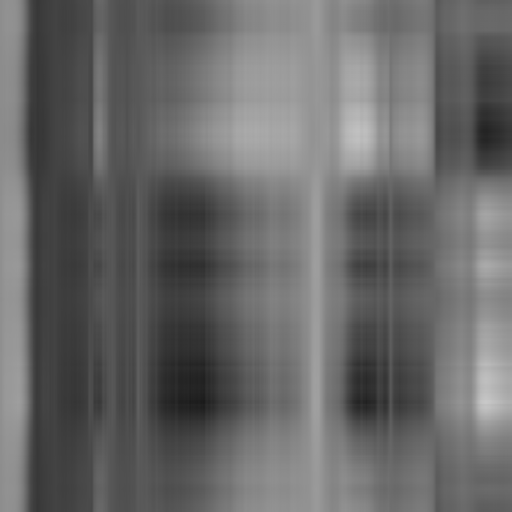
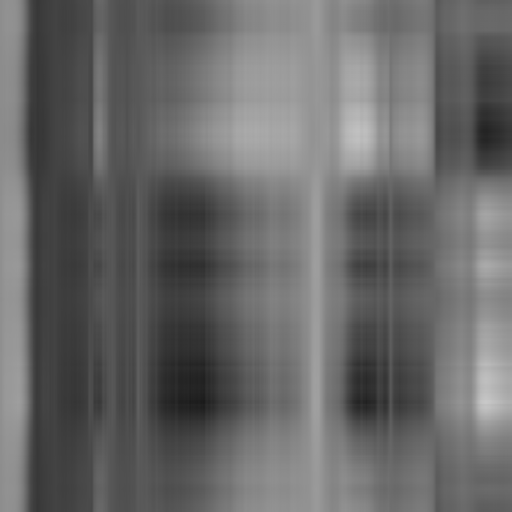
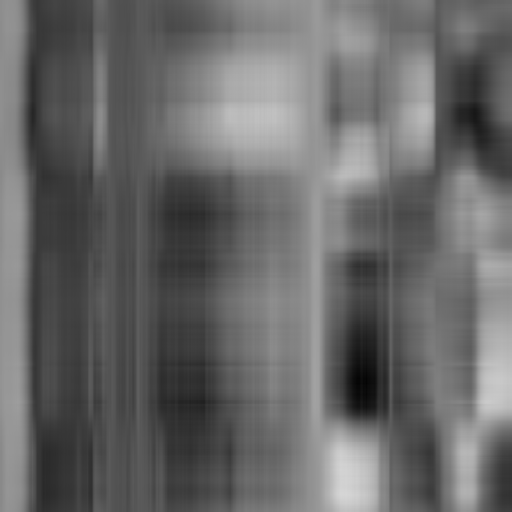
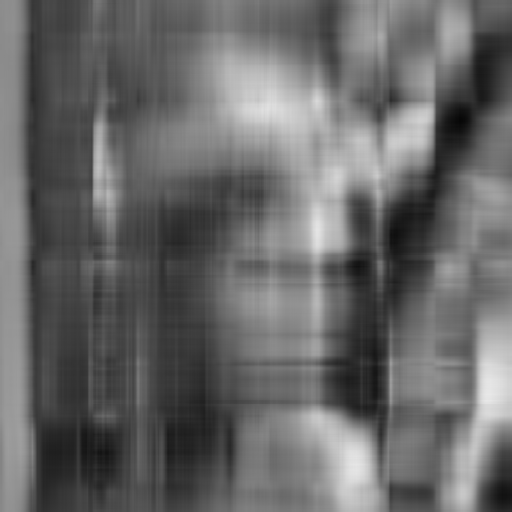
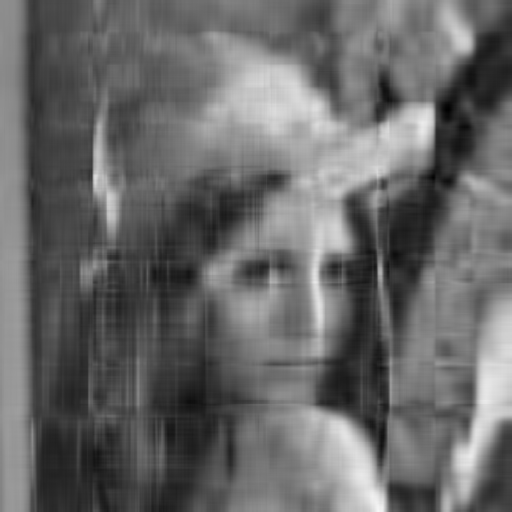
...
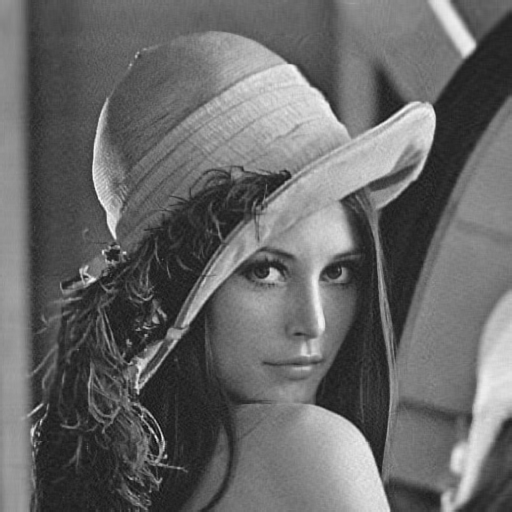
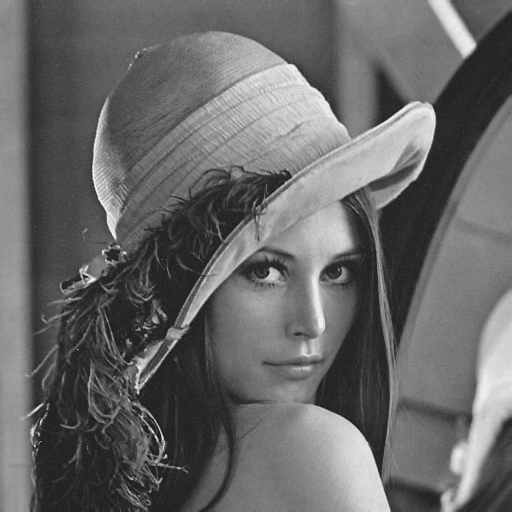
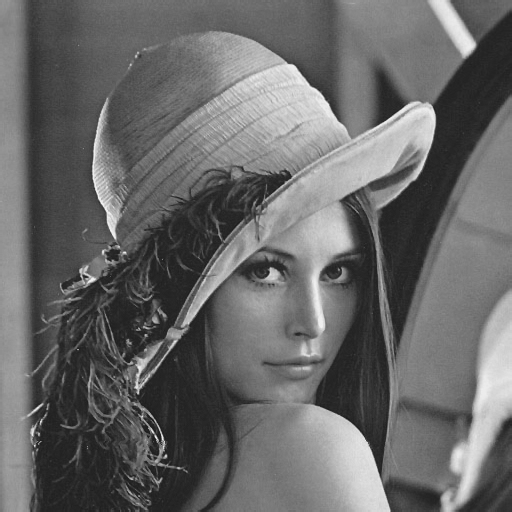
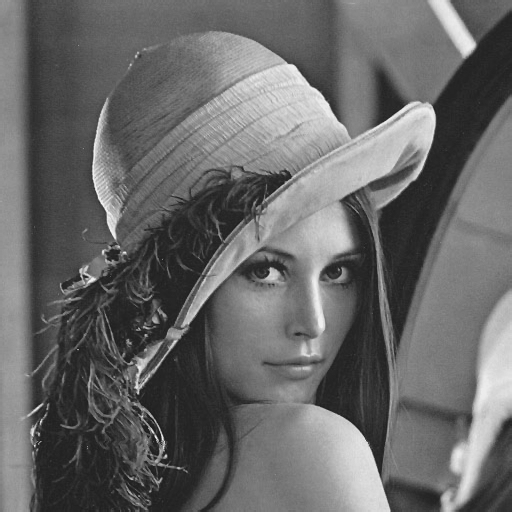
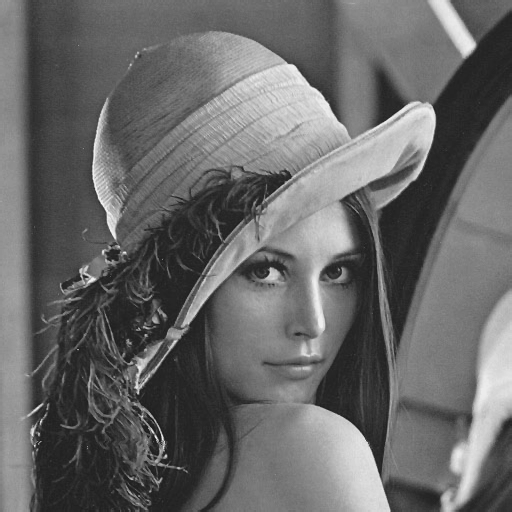

In [15]:
imgs = []
components = np.array([1, 2, 5, 10, 25, 50, 100, 200, 300,400, 512])

for n_comp in components:
    W = pca.transform(X, n_components=n_comp)
    img_reconstructed = pca.inv_transform(W, n_components=n_comp)
    imgs.append(img_reconstructed)
    
imgs=np.array(imgs, dtype=float)

fig = px.imshow(imgs,animation_frame=0, binary_string=True, labels=dict(animation_frame="num components"))
fig.update_layout(title = 'Lena reconstructed', 
                  sliders = [dict(name='Components',steps=[{'label':f'{x}'} for x in components])]
                 )


for i, frame in enumerate(fig.frames):
    frame.layout.title = f"Lena reconstructed: {components[i]} components ({pca.cumulative_variance_explained[components[i]-1]*100:.2f}% var explained)"
    
for step in fig.layout.sliders[0].steps:
    step["args"][1]["frame"]["redraw"] = True

fig.show()
imgs = None

## Example - Fifa 19 dataset

For the next part I will use a dataset containing all the players present in EA Fifa 19 (https://www.kaggle.com/karangadiya/fifa19). For each player, 88 attributes are recorderded. Some of them are generic attributes as "Name", "Nationality", "Photo" that is the url of the thumbnail or "Release Clause".

The attributes interesting for this part are the ones from column 53 to 87. These 34 attributes are related to different skills covering different technical areas like 'Finishing' or 'LongShoot' for strikers, 'Passing' and 'Vision' for midfielders, 'Tackling' and 'Interception' for defenders and 'GKDiving' and 'GKReflexes' for goalkeepers. For each player a score in the range $[0,100]$. The whole set of scores contributes to the **overall score** of the player.

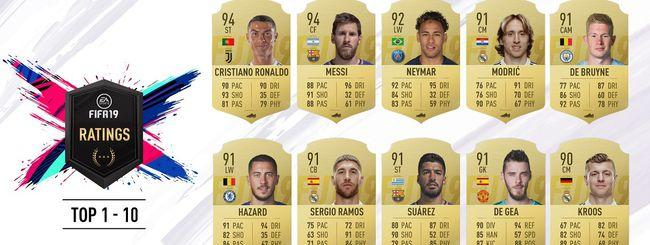

In [44]:
df = pd.read_csv('data.csv', index_col=0)
features = df.columns[53:-1].tolist()
target = 'GeneralPosition'


mask_nan = np.any(np.isnan(df[features].values), axis=1)
df = df[~mask_nan]
X = df[features].values

df.head()

,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,Club Logo,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,https://cdn.sofifa.org/teams/2/light/241.png,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,€226.5M
1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,https://cdn.sofifa.org/teams/2/light/45.png,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,€127.1M
2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,https://cdn.sofifa.org/teams/2/light/73.png,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,€228.1M
3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,https://cdn.sofifa.org/teams/2/light/11.png,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,€138.6M
4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,https://cdn.sofifa.org/teams/2/light/10.png,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,€196.4M


In [45]:
# print(features)
color_player_dict

{'#1f77b4': 'GK', '#ff7f0e': 'DF', '#2ca02c': 'MF', '#d62728': 'ST'}

In Fifa 19 a lot of different *Positions* are considered to each area of the field. To simplify the analysis each player is mapped to the area of the field which is more close to his position. In this manner, only 4 categories are considered as **GeneralPosition** : *Striker*, *Midfielder*, *Defender* and *Goalkeeper*.

In [46]:
def map_position_to_general(position):
    if position in ['ST', 'LF', 'CF', 'RF', 'LS', 'RS']:
        return 'ST'
    elif position in ['LW', 'CAM', 'RW', 'LM', 'CM', 'RM', 'CDM', 'LAM', 'RAM',
                     'LCM', 'LDM', 'RCM', 'RDM']:
        return 'MF'
    elif position in ['LWB', 'LB', 'CB', 'RB', 'RWB', 'LCB', 'RCB']:
        return 'DF'
    else:
        return 'GK'
    

df['GeneralPosition'] =df.Position.apply(map_position_to_general)
player_color_dict = {'GK': 0, 'DF': 1, 'MF': 2, 'ST': 3}
color_player_dict = {DEFAULT_PLOTLY_COLORS[v] : k for k,v in player_color_dict.items()}
df['Color'] = [DEFAULT_PLOTLY_COLORS[player_color_dict[k]] for k in df.GeneralPosition]

df[['Name', 'Position', 'GeneralPosition']].head()

,Name,Position,GeneralPosition
0,L. Messi,RF,ST
1,Cristiano Ronaldo,ST,ST
2,Neymar Jr,LW,MF
3,De Gea,GK,GK
4,K. De Bruyne,RCM,MF


In [47]:
pca = myPCA()
pca.fit(X)

V = pca.components_


tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   title=f'PCA: Relative variance explained',
                   text='var',
                   color='var'
                  )

fig.update_traces(texttemplate='%{text:.3f}', textposition='outside')


fig.update_layout(
     yaxis={'range':[-0.01, 0.7]}, xaxis={'range':[-0.05, 20]},
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                  ticks="outside", title='',ticksuffix=" var"))
fig.show()
df_variance = None


## Intepreting Principal Components Results

### Physical interpretation
Another way to look at the formulation of this problem is to consider each sample $x_i \in X.T, i=0,\ldots,n$ as a physical point and so the whole dataset as a phisical body. 
We can define the *inertia of a column* as the sum of the squared elements of the column:

$$ I_j^2 = \sum_{i=0}^m x_{i,j}^2 $$

The sum of all the column inertias is called *total inertia* or simply *inertia* of the data table:

$$ I = \sum_{j=0}^n I_j^2 = \sum_{j=0}^n\sum_{i=0}^m x_{i,j}^2 $$

The *center of gravity* $g$ is the vector of the means of each column of $X$, and the distance of each point from the baricenter is given by:

$$ d_{i,g}^2 =\sum_{j=0}^m (x_{i,j} - g_j) ^2 $$

Consider to put the dataset in meand-deviation form, or in this case to shift the body s.t. the baricenter is positioned to the origin. We have now that $g = \mathbb 0 \in\mathbb R^n$ and the distance of each point is:

$$ d_{i,g}^2 =\sum_{j=0}^m (x_{i,j}) ^2 = I_i $$

> The principal components are the **axes of inertia** of the body. The importance of each component is given by the proportion of inertia "explained"

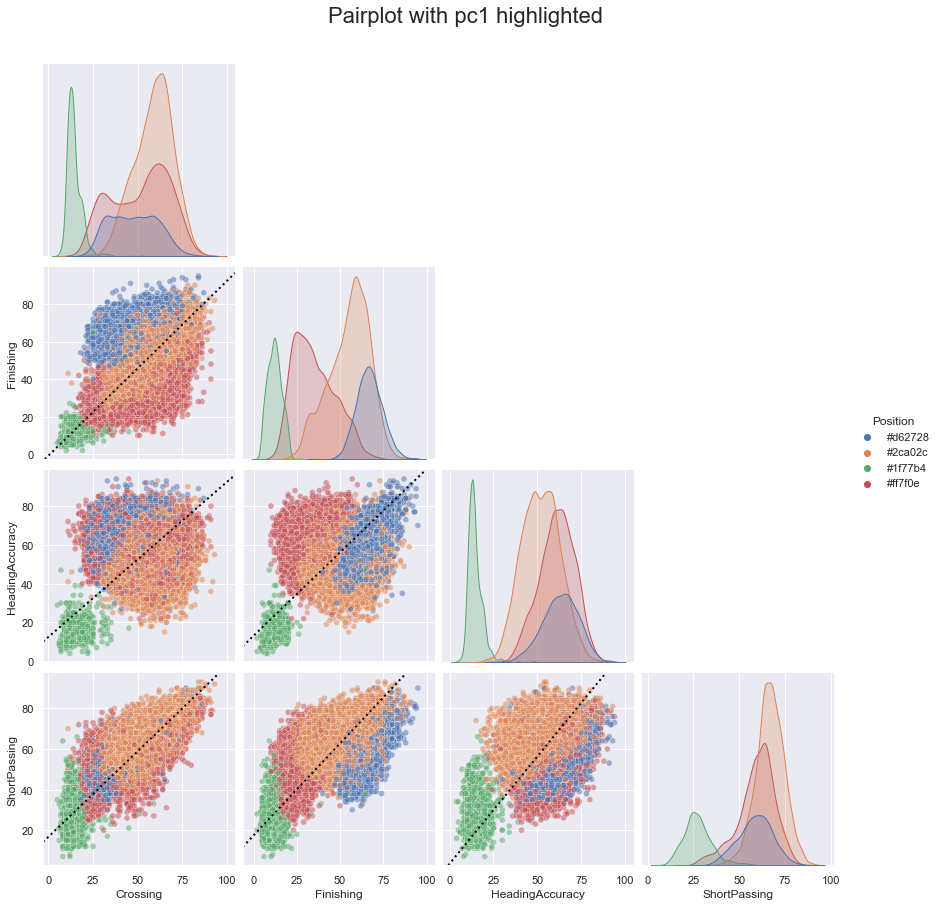

In [48]:
old_features =features
features = features[:4]
means = df[features].mean(axis=0)

g = sns.pairplot(df[features+[target, 'Color']],hue='Color', diag_kind='kde', height=3,  corner=True,
                 plot_kws={'alpha': 0.5})

g.fig.suptitle("Pairplot with pc1 highlighted", y=1.05, size=22) # y= some height>1


allaxes = g.fig.get_axes()
for i in range(1,len(features)):
    for j in range(i+1, len(features) + 1):
        mu = means.loc[[features[i-1], features[j-1]]].values
        u = np.array([V[:,0][i-1], V[:,0][j-1]])
        ax = allaxes[sum(range(j)) + i-1]
        ax.axline((-u[0] + mu[0], -u[1] + mu[1]), (u[0] + mu[0], u[1] + mu[1]), 
                  linestyle=':', c='black',lw=2, alpha=1, label='pc1 projected')


g._legend.set_title('Position')
features = old_features

In the picture above are plotted the pair-plots of the first three features. Pair-plots are a very simple way to investigate *how variables interact in couples*. The plots are organized in a grid of dimension $\text{num_features}\times \text{num_features}$. In the plots $(i,j)$ outside the diagonal ($i\neq j$) are depicted the scatter plots of the coupled variables $i$ and $j$. Here we can investigate the interactions between these two variables.The diagonal plots are treated differently: a univariate distribution plot is drawn to show the marginal distribution of the data in each column.

The dotted line in black in the picture is the first principal component projected, in each subplot along the two corresponding variable. As we can clearly see, if we consider the storm of points as a physical body, the first principal component is the ax the capture the maximum inertia possible of the body.

### Loadings

The matrix $V$ is called the *loadings matrix*. As seen before, each principal component is constructed as a linear combination of the original variables. The matrix $V$ contains the **coefficients of the linear combination**. In particular, for example considering the value $v_{i,k}$ it is the contribution of variable $i$ to the component $k$.

For each component we can plot the loadings as a barplot to look at the contirbution of each one of the original variables. Opposing positive and negative contributing features can help us to give an interpretation to the principal component

In [55]:
pc1 = pca.components_[:,0]
pc2 = pca.components_[:,1]

fig = make_subplots(rows=2, cols=1, subplot_titles=("pc1 Loadings", "pc2 Loadings"),
#             shared_xaxes=True,
            vertical_spacing=0.2 )
colors = np.full(len(pc1), 'lightgray')
colors[pc1 > 0.1] = 'crimson'
colors[pc1 < -0.1] = '#1f77b4'
fig.add_trace(go.Bar(
            y=pc1,
            x=features, marker_color= colors
            ), row=1, col=1)


colors = np.full(len(pc1), 'lightgray')
colors[pc2>0.15] = 'crimson'
colors[pc2<-0.16] = '#1f77b4'

fig.add_trace(go.Bar(
            y=pc2,
            x=features,marker_color= colors
            ), row=2, col=1)
fig.update_layout(height=800)
fig.update_layout(title='Loadings')

# fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
# rotate labels
fig.update_xaxes(tickangle=-45,showgrid=True, row=1, col=1)
fig.update_xaxes(tickangle=-45,showgrid=True, row=2, col=1)


The vertical barplots give us some important insight on the behaviour of the first two principal components. From the first plot we can see a clear positive contribution of Goalkeepr's attributes and a negative contribution of all the other attributes. The second plot, at a first glance seems to be less clear. However highlighting the most important attributes in absolute level, we can see a positive contribution of defensive attributes as 'Tackle', 'Marking' and 'Interception' and a negative contribution of attributes like 'Finishing', 'Longshots' and 'Volleys'. From the 2 plots above we can clearly interprete:
1. The first component is a discriminant between **Goalkeeprs** and other players
2. The second component is a discriminant between **Offensive/Defensive** players

### Contribution of each observation
Consider the svd decomposition $X = U\Sigma V^T$, we have that the matrix of the factor scores:

$$ F = XV = U\Sigma V^T V =  U\Sigma$$

and so we have that the sum of the squared factors for each component is equal to the corresponding eigenvalue"

$$ F^TF = \Sigma^TU^TU\Sigma = \Sigma^T\Sigma \underset{\Sigma \text{ diagonal}}{=} \Sigma^2 $$

Having this in mind, we can quantify the contribution of each observation to a component as:

$$ ctr_{i,k} =\frac{f_{i,k}^2}{\sum_{j=0}^mf_{j,k}^2} = \frac{f_{i,k}^2}{\lambda_k} $$

Obvsiously the contribution of each observation is in the range [0,1] while the sum of all the contributions for a component is $\sum_{j} ctr_{j,k} = 1$. 

> A tipical heuristic approach is based on interpreting the principal components considering the observation whose contribution is greater than the average contribution. In this case the observations that differ in sign can be opposed as the endpoints of the component


In [57]:
def contribution(X, pca, k):
    f = pca.transform(X)[:,k] **2
    return f/sum(f)


In [69]:
k = 0
ctrs0 = contribution(X, pca, 0)
ctrs1 = contribution(X, pca, 1)

df_temp = pd.DataFrame({'id': df.ID, 'contribution pc 1':ctrs0, 'contribution pc 2':ctrs1, target:df[target].values})
fig = px.scatter(df_temp, x = 'contribution pc 1', size=ctrs0*ctrs1*100, y='contribution pc 2', color=target, hover_data=['id'])
ix = np.argmax(ctrs0*ctrs1*100)
fig.add_annotation(ARROW_ANNOTATION(ctrs0[ix], ctrs1[ix], "Who's this?"))
fig.update_layout(title="Contribution to first 2 pc (size=ctr1*ctr2)")
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig.show()

The contribution plot enforce our beliefs. We can see how the players that contribute the most to the first component are goalkeepers, while in the second component there is a hetergoeneous contribution of 'ST', 'MF' and 'DF'.

Highlighted in the plot there is a point whose contribution is very high in the second component, but also quite high in the first. Indeed, this player has the highest contribution of the entire dataset


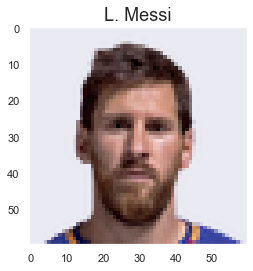

In [95]:
from PIL import Image
import io

import requests

# Extract player id

id_player =df_temp.iloc[ix].id
info = df[df.ID == id_player]

# Extract info
photo_url = f'https://cdn.sofifa.com/players/{str(id_player)[:3]}/{str(id_player)[3:]}/19_60.png'
name =  info.Name
info.set_index('Name', inplace=True)

# Download photo
my_referer = 'https://sofifa.com/?r=190075&set=true'
s = requests.Session()
s.headers.update({'referer': my_referer})
r = s.get(photo_url)

# Show photo
image = Image.open(io.BytesIO(r.content))
fig, ax = plt.subplots()
ax.imshow(image)
fig.set_facecolor("white")
plt.title(name.item(), size = 18)
plt.grid(None)
plt.show()

Digging into the dataset we can retrieve the informations relative to this player and we can see how this is not 'a player' but it's Lionel Messi, the highest overall-rated player in Fifa 19. Aside from it's overall, it's contribution to the goalkeeper component is probably due also to the fact that it has a score relative to 'GKKicking' and 'GKPositioning' and 'GKHandling' higher than the average of non-GK players

In [96]:
GK_attributes = ['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']
df_temp = pd.DataFrame(columns = GK_attributes, index=['mean', 'std'])
df_temp.loc['mean'] = df[df[target] != 'GK'].mean()[GK_attributes].values
df_temp.loc['std']  = df[df[target] != 'GK'].std()[['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']].values

print('Mean and std of GK attributes for non-GK players:\n')
print(df_temp)
stats = df[df.ID==id_player][['GKDiving', 'GKHandling','GKKicking', 'GKPositioning', 'GKReflexes']]
stats.index = name
stats

Mean and std of GK attributes for non-GK players:

      GKDiving GKHandling  GKKicking GKPositioning GKReflexes
mean  10.49907  10.556445  10.550118     10.529215  10.508436
std   3.095231   3.073416   3.140666      3.079219   3.100045


,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
Name,,,,,
L. Messi,6.0,11.0,15.0,14.0,8.0


Finally we can plot the simple scores of the each observation along the first two components. This practically are the coefficients of each observation in the PCA base. Also from this plot we can clearly see how the first component is an attribute of **'Goalkeepingness'** while the second component is an attribute of **'Offensiveness'**

In [74]:
f = pca.transform(X, n_components=2)
ctrs0 = f[:, 0]
ctrs1 = f[:, 1]

df_temp = pd.DataFrame({'id': df.ID, 'contribution pc 1':ctrs0, 'contribution pc 2':ctrs1, target:df[target].values})
fig = px.scatter(df_temp, x = 'contribution pc 1', y='contribution pc 2', opacity=0.15,color=df.GeneralPosition, hover_data=['id'])

fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))
fig.show()

### Correlation between a Component and a Variable
The correlation between a component and a variable estimates the information that they share. In the PCA framewokrk, this correlation is called *loading*.

Using the loadings as coordinates we are able to plot the varibles as points in the component space. Since the sum of the squared variables is equal to 1, a good way to plot them in a 2D space is to consider the unitary **circle of correlations**.

When the data are perfectly represented by only two components, the sum of the squared loadings is queal to one, and so the loading will be positioned on the circle. When two components are not enough the variables will be positioned inside the circle.

> The closer a variable is to the circle of correlations, the better we can reconstruct it from the first two components


In [78]:
W = pca.fit_transform(X)
A, B = np.array(W.T), np.array(X.T)
# A, B = np.array(W), np.array(X)

# Rowwise mean of input arrays & subtract from input arrays themeselves
A_mA = A - A.mean(1)[:, None]
B_mB = B - B.mean(1)[:, None]

# Sum of squares across rows
ssA = (A_mA**2).sum(1)
ssB = (B_mB**2).sum(1)

# Finally get corr coeff
corrs = np.dot(A_mA, B_mB.T) / np.sqrt(np.dot(ssA[:, None], ssB[None]))

(corrs**2).sum(axis=0)

features_to_plot = features
df_corrs = pd.DataFrame(corrs.T, index=features_to_plot)
df_corrs = df_corrs[[0,1]]


relative_variance = np.array(pca.relative_variance_explained)*100

fig = go.Figure()

fig.add_shape(type="circle",
    xref="x", yref="y",
    fillcolor="PaleTurquoise",
    opacity=0.2,
    x0=-1, y0=1, x1=1, y1=-1,
    line_color="LightSeaGreen",
)

fig.add_trace(go.Scatter(x=df_corrs[0], y=df_corrs[1], mode='markers+text',text=features_to_plot,
                         textfont=dict(size=12),
                         textposition = 'top center',
                         marker= dict(symbol='diamond-dot', color='crimson')
                        ))
fig.update_layout(yaxis=dict(scaleanchor = "x",scaleratio = 1, range=[-1.2,1.2], title=f'pc2 ({relative_variance[1]:.2f}% var)'),
                  xaxis=dict( range=[-1.2,1.2], title=f'pc1 ({relative_variance[0]:.2f}% var)'),
                  height= 700,
                  title = 'Correlation Circle (first 2 pc)'
                 )
fig.show()


## Evaluating the quality of the model
### Fixed Effect Model
When the original dataset is considered to be the population of interest (we have all the data at the beginning and we work only on it as in the previous examples) PCA corresponds to a **Fixed Effect Model**. In this case in fact, the model parameters are fixed or non-random quantities. In this case PCA is *descriptive* and the the amount of variance of $X$ explained by a component indicates exactly its importance. In this case, we can quantify the quality of the PCA considering only the first $k$ components, as the *reconstruction error*. Consider the matrix $\hat X_{(k)}$ that is the approximation of $X$ considering only the the first $k$ components.

$$ \begin{aligned}\hat X^{(k)} &= U^{(k)}\Sigma^{(k)}V^{(k)T}\\
                               &= F^{(k)}V^{(k)T}\\
                               &= XV^{(k)}V^{(k)T}
   \end{aligned}
$$

Practically we are prokecting our original dataset $X$ onto the first $k$ principal components $V_{(k)}$, and then we are reconstructing an approximation of the original matrix with the inverse operation $V_{(k)}^T$ (inverse since $V$ is orthonormal). This approximation carries an error, due to the fact that we are considering only the first $k$ components

$$ X = \hat X^{(k)} + E $$

where $E$ is a matrix accounting for the error $X - \hat X_{(k)}$. We can quantify this error in different manner, but the most widely adopted approach is to consider the **Residual Error Sum of Squares**:

$$ \begin{aligned}RESS_k &= \|X - \hat X_k\|_F^2\\
                         &= \mathcal I - \sum_{i=1}^k \lambda_i\\
                         &= \sum_{i=k+1}^n \lambda_i
   \end{aligned}
$$

where $\|\cdot\|_F$ is the Frobenius norm. This error is quantifiable also as the sum of the eigenvalues which we are neglecting. The lower is the RESS the better is the model. Obviously increasing the number of components we will have a better estimation and considering $k=n$ all the components we will be able to reconstruct the original matrix $X$ perfectly.
   

### Random Effect Model
Tipically the dataset that we have is only a subset of observations of the real population. Our goal is to estimate the value of new observations from this population. This framework correspod to a **Random Effect Model**. In this case, due to the randomness, we have to adopt different strategies to evaluate our PCA model. Usually these are based on *computer-based resampling techniques* such as **bootstrap** and **cross-validation**.

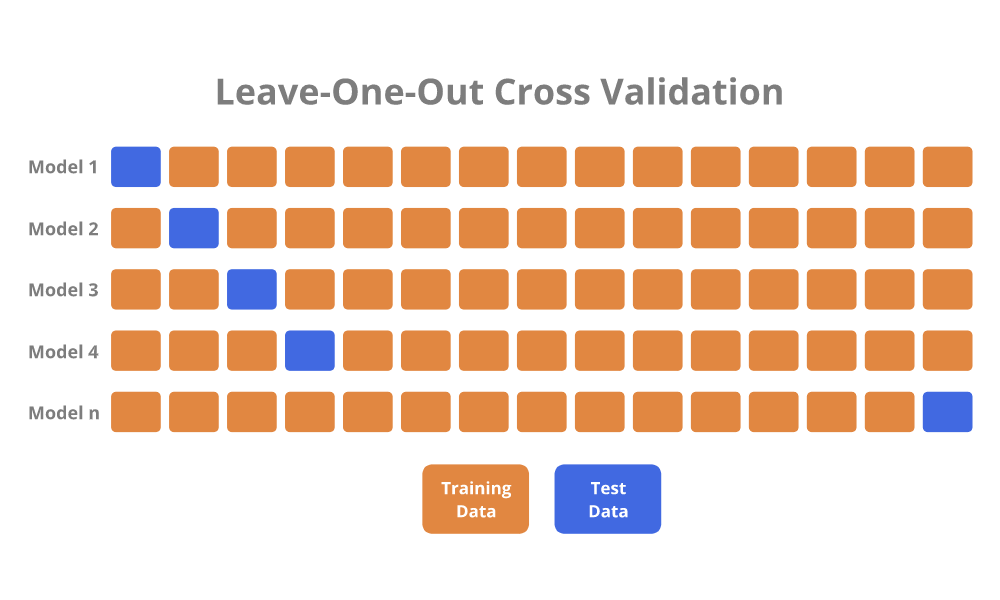

A popular cross-validation technique adopted in this context is the **jackknife** (or Leave One Out). In this procedure each observation is selected in turn, to form the test set. The remaining observations constitute the training set.
Then we will infere the PCA model on the training set and computing an estimation of the left-out sample considering the first $k$ component, according to a random effect model. We can store all this estimations in a matrix $\tilde X$ and finally computing the estimation error w.r.t. the original matrix $X$. Note that in this case we tipically talk of **Predicted Residual Error Sum of Squares**:

$$ PRESS_k = \|X - \tilde X_k\|_F^2 $$

As in the previous case the lower is the PRESS the better is the model. Note also that in contrast with the fixed effect model, even considering all the components we have *no guarantees to reconstruct perfectly X*.

> This problem shows up particularly when the number of variables is larger than the number of observations. This problem is referred to as the 'small N large P' in the literature

In [ ]:
from sklearn.model_selection import KFold
def RESS(X, n_comp):
    B = X - X.mean(axis=0)
    
    if n_comp <= 0:
        return(np.sum(B**2))
    
    pca = PCA(n_components=n_comp)
    pca.fit(B)
    W = pca.transform(B)
    
    X_tilde = pca.inverse_transform(W)
    
#     return mean_squared_error(X,X_tilde)
    return np.sum((B - X_tilde)**2)


def LVOO(X):
    for i in range(len(X)):
        mask = np.full(len(X), True)
        mask[i] = False
        yield (X[mask, :], np.atleast_2d(X[i,:]))
        

# def CROSSVAL(X, )
    

def PRESS(X, n_comp, which='all'):
    B = X - X.mean(axis=0)
    X_tilde = []
    
    if n_comp <= 0:
        return(np.sum(B**2))
    
    if which == 'all':
        start_ind = 0
    else:
        start_ind = n_comp
    
    
    s = np.zeros(n_comp)

    kf = KFold(n_splits=7)
    for train_index, test_index in kf.split(B):
        train, test = B[train_index], B[test_index]
        pca = myPCA(n_components=n_comp)
        pca.fit(train)
        
        W = pca.transform(test, n_components=n_comp)
        
        for k in range(start_ind, n_comp):
            x_tilde = pca.inv_transform(W[:,:k])
            s[k-1] += np.sum((x_tilde - test)**2)

    s /= 7
    
    
#     for train,test in LVOO(B):
#         pca = myPCA(n_components=n_comp)
        
#         pca.fit(train)
#         x_tilde = pca.inv_transform(pca.transform(test, n_components=n_comp))#pca.inv_transform(test)
        
#         s+=np.sum((x_tilde - test)**2)

        
    return s

In [ ]:
p = X -X.mean(axis=0)
p = p/X.std(axis=0)

s = np.zeros(10)
kf = KFold(n_splits=7)
for train_index, test_index in kf.split(p):
    train, test = p[train_index], p[test_index]
    break

### Number of Components
In many cases, we are only interested in extracting the important information from the dataset, *reducing the dimensionality* of the dataset as much as possible. So in this case we only want to know how many component we want to keep.
This question is not solved, but there are some useful guidelines to help us in our decision:

1. **Elbow method**: a first heuristic approach is to plot the eigenvalues according to their importance and look if in the graph there is point where the slope of the curve goes from steep to flat. This point is usually referred to as 'the elbow' and the procedure as the *scree* or *elbow test*


2. **Average method**: another traditional heuristic approach is to consider only the components whose contribution is larger than the average contribution, or in other words to consider only the components such that $\lambda_k > \frac{\sum_{i=1}^n\lambda_i}{n} = \frac{\mathcal I}{n}$. Note that in the case of a correlation PCA this boils down to only the components with $\lambda_k > 1$

In [111]:
# pca = myPCA()
# pca.fit(X)
V = pca.components_

tot_variance = np.sum(pca.lambdas)
variance_explained = pca.relative_variance_explained
cum_var = pca.cumulative_variance_explained

df_variance = pd.DataFrame({'var':variance_explained,'pc':np.arange(len(variance_explained)) + 1})

fig = go.Figure()



df_variance['color'] = [DEFAULT_PLOTLY_COLORS[4]]* len(df_variance)
fig = px.bar(df_variance, x='pc', y='var', labels={'var':'Variance Explained', 'pc':'Principal Component'}, 
                   text=[f'{x:.2f}' if i <= 5 else '' for i,x in enumerate(df_variance['var'])],
                    opacity = 0.15,
                    color = df_variance.color
                  )

fig.update_traces(textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.add_trace(go.Scatter(x=list(np.arange(len(variance_explained))+1),
                         y=list(pca.relative_variance_explained) +[0],
                         mode='lines+markers',
                         opacity = 0.8,
                         marker=dict(size=6, color=DEFAULT_PLOTLY_COLORS[0], symbol='diamond'),
                         name='cum var'))

fig.add_trace(go.Scatter(x=[0,len(pca.lambdas)], y=[np.mean(variance_explained)]*2,mode='lines',line={'color':'red','dash':'dot','width':1.5}))


arrow = ARROW_ANNOTATION(3,pca.relative_variance_explained[2], 'ELBOW')
k = 2
arrow['font'] = dict(color=DEFAULT_PLOTLY_COLORS[k], size=18)
arrow['arrowcolor'] =DEFAULT_PLOTLY_COLORS[k]
arrow['arrowhead'] = 2
arrow['arrowwidth'] =1
arrow['ax'] = 100
arrow['ay'] = -200
fig.add_annotation(arrow)
fig.add_annotation(go.layout.Annotation(
            x=12,
            y=0.05,
            xref="x",
            yref="y",
            text='Average contribution',
            showarrow=False,
            ))

fig.update_layout(title = 'Skree plot',
                  showlegend=False,
                  xaxis=dict(range=[0,15]),
                  yaxis=dict(range=[0,0.7]),
                  coloraxis_colorbar=dict(yanchor="bottom", y=-0.05, x=1.01,
                                          ticks="outside",
                                          title='',
                                          ticksuffix=" var"))
fig.show()

#### Random Model
In the case of random models increasing the number of components we can face overfitting phenomena. In these cases is critical to consider the number of components having in mind the goal of generalize the model. 

- A simple approach consist in stop adding components when the $PRESS$ decreases

Another approach is to compute for each compoenent the quantity:

$$ Q_k^2 = 1 - \frac{PRESS_k}{RESS_{k-1}} $$

considering $RESS_0 = \mathcal I$. In this case we will consider only the components with $Q_k^2$ greater or equal to an arbitrary critical value. A vastly adopted threshold is $1 - 0.95^2 = 0.0975$ ... add references

Another approach based on cross-validation is to compute the score:

$$ W_k = \frac{PRESS_{k-1} - PRESS_k}{df_k}+\frac{PRESS_k}{df_{residual,k}} $$

where $PRESS_0 = \mathcal I$, $df_k = n+ m - 2k$ is the number of degrees of freedom of the $k$-th component and $df_{residual,k} = n(m-1) - \sum_{i=1}^k df_i$ is the residual number of degrees of freedom, which is euqal to the total number of degrees of fredoom $n(m-1)$ minuse the number of degrees of freedom already 'used'.

> Tipically $W_k$ will give a more conservative estimate of the number of comopnents w.r.t. $Q_k^2$.


#### Confidence interval
Note that after we have decided the number of components to keep, we can compute **confidence intervals** for the eigenvalues of $\tilde X$ using bootstrap. To do this, we can simply draw a large number of samples with replacement from the learning set. Each set produce a set of eigenvalues. The whole set of eigenvalues can then be used to compute the confidence intervals



In [ ]:
def Q_square(X, k):
    return 1 - PRESS(X, k)/RESS(X, 0)
#     return 1 - (PRESS(X, k) / RESS(X, k-1))


def degrees_of_freedom(m,n,k):
    return n + m - 2*k

def residual_degrees_of_freedom(m,n,k):
    return n*(m-1) - np.sum([degrees_of_freedom(n,m,i) for i in range(1,k+1)])

def W_square(X, k):
    df_k = degrees_of_freedom(*X.shape, k)
    rdf_k = residual_degrees_of_freedom(*X.shape, k)
    
    press_k = PRESS(X,k)
    print(press_k)
    return (PRESS(X,k-1) - press_k) / df_k + (press_k / rdf_k)
    
q2_list = []
w_list = []
for i in range(1,X.shape[1]+1):
    q2 = Q_square(p[:100], i)
    q2_list.append(q2)
    
    w = W_square([p[:100], i)
    w_list.append(w)
    

fig = go.Scatter(x = np.arange(X.shape[1]) + 1, y = q2_list, mode = 'lines+markers')
    

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = np.arange(X.shape[1]) + 1, y = w_list, mode = 'lines+markers'))

fig.show()

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = np.arange(X.shape[1]) + 1, y = q2_list, mode = 'lines+markers'))

fig.show()

# PCA Extensions
PCA is a linear method. That is it can only be applied to datasets which are linearly separable. It does an excellent job for datasets, which are linearly separable. But, if we use it to non-linear datasets, we might get a result which may not be the optimal dimensionality reduction. Kernel PCA uses a kernel function to project dataset into a higher dimensional feature space, where it is linearly separable. It is similar to the idea of Support Vector Machines.

There are various kernel methods like linear, polynomial, and gaussian.




In [114]:
import math

def circular_points_2D(r, std=1, N=10, center=(0,0)):
    points = []
    
    for _ in range(N):
        random_r = np.random.normal(r, scale = std)
        theta = np.random.uniform(0, 2*math.pi)
    
        x = center[0] + random_r * math.cos(theta) 
        y = center[1] + random_r * math.sin(theta)
        points.append((x, y))
    return points

colors = ['rgb(199,0,0)'] * 100 + ['rgb(31, 119, 180)'] * 100
colors_pr = ['rgba(199,0,0,0.2)'] * 100 + ['rgba(31, 119, 180, 0.2)'] * 100
X_pos = circular_points_2D(25, N=100, std=1)
X_neg = circular_points_2D(10, N=100, std=1)
X = np.vstack((X_pos, X_neg))

pca = myPCA()
W = pca.fit_transform(X)


fig = make_subplots(rows=2, cols=2, column_widths=[0.1, 0.9], row_heights=[0.8, 0.2], vertical_spacing=0.1,
                    subplot_titles=("pc2 projection", '2D circular points', '',"pc1 projection")
                   )

fig.add_trace(go.Scatter(x=X[:,0], y=X[:,1], mode='markers', marker=dict(color=colors)),row=1, col=2)

fig.add_trace(go.Scatter(x=[np.random.normal(0,0) for _ in range(200)], y=W[:,1], mode='markers',marker=dict(color=colors_pr)),
              row=1, col=1)

fig.add_trace(go.Scatter(y=[np.random.normal(0,0) for _ in range(200)], x=W[:,0], mode='markers',marker=dict(color=colors_pr)),
              row=2, col=2)



fig.update_layout(height=700, showlegend=False)
fig.show()



It's clear form the plot that we cannot find a linear boundary that separates in a satisfactoyr manner the two classes. Even allowing for some erros the resulting halfpsace will be not useful at all.
The solution to this problem is to enrich the class of halfspaces. The idea is simple: first we map the samples to another space (generally of higher dimension) and then we search for a halfspace that separates the points in the new space.

## Kernel PCA
For example in the case above we can consider a mapping function $\psi: \mathbb R^2 \rightarrow \mathbb R^3$ that maps $(x, y) \mapsto (x, y, x^2 + y^2)$. The range space of $\psi$ is called **feature space**

In [115]:
def mapping_fun(point):
    x, y = point
    return (x, y, x**2 + y**2)

X_features = np.array(list(map(mapping_fun, X)))
x = X_features[:,0]
y = X_features[:,1]
z = X_features[:,2]

In [117]:
pca = myPCA()
W = pca.fit_transform(X_features)

# fig = px.scatter_3d(x = x, y=y, z=z, color=colors, opacity=0.99)

fig = make_subplots(rows=1, cols=2, column_widths=[0.2, 0.8],
                    subplot_titles=("PCA projection",  f'${"Feature space:"}\psi : (x, y) \mapsto (x, y, x^2 + y^2)$'),
                   specs = [[{'type':'xy'}, {'type':'scene'}]])

fig.add_trace(go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',


    marker=dict(
        
        color=colors,
        opacity=0.8
    )), col=2, row=1)

fig.add_trace(go.Scatter(x=W[:,1], y=W[:,0], mode='markers', opacity = 0.8,marker=dict(color=colors)),
              row=1, col=1)

fig.update_yaxes(title='pc1', row=1, col=1)
fig.update_xaxes(title='pc2', row=1, col=1)
fig.update_layout(
    showlegend=False,
    scene_camera =  dict(
    up=dict(x=0, y=0, z=1),
    center=dict(x=0, y=0, z=0),
    eye=dict(x=1, y=1, z=0.45)
))
fig.show()

In this new 3D feature space the points are linearly separable using a two dimensional plane and so we can use a classic soft/hard-SVM approach.
We can sum up the whole idea of kernel-SVM in four main points:
1. Given a domain set $\mathcal X$, choose a mapping $\psi: \mathcal X \rightarrow \mathcal F$ for some feature space $\mathcal F$ that is an Hilber space
2. Map the points of the training set $S = \{(\mathbf x_1, y_1), \ldots, (\mathbf x_m, y_m)\}$ to the the feature space $\hat S= \{ (\psi(\mathbf x_1), y_1), \ldots, (\psi(\mathbf x_m), y_m)\}$
3. Train a linear predictor $h$ over $\hat S$
4. Given a new point $\mathbf x$ predict its label as $h(\psi(\mathbf x))$

Practically the success of this learning paradigm boils down to the choice of a good mapping function $\psi$. 


### Kernel Trick

Tipically the feature spaces have an higher dimensionality than the original space. Computing a linear separator in a high dimensional space can be computationally expensive. The solution to this problem is *kernel base learning*.
Given a function $\psi:\mathcal X\rightarrow \mathcal F$, where $\mathcal F$ is an Hilbert space, we define a **kernel function** as:

$$ K(\mathbf x, \mathbf x') = \langle \psi(\mathbf x),\psi(\mathbf x')\rangle, \qquad \mathbf x, \mathbf x' \in \mathcal X$$

> The kernel function is a similarity measure between two points corresponding to an inner product in the space $\mathcal F$


Note that all the previous formulations of SVM problem can be expressed in the form:

$$ \underset{\mathbf w}{\min} \bigg(f\big(\langle \mathbf w, \psi(\mathbf x_1),\rangle, \ldots, \langle \mathbf w, \psi(\mathbf x_m),\rangle\big) + R(\|\mathbf w\|)\bigg)$$

where $f : \mathbb R^m \rightarrow \mathbb R$ and $R: \mathbb R_+ \rightarrow \mathbb R$

- soft-SVM can be derived letting $R(a) = \lambda a^2$ and $f(a_1, \ldots, a_m) = \frac{1}{m}\sum_{i=1}^m \max(0, 1 - y_ia_i)$
- hard-SVM can be derived letting $R(a) = a^2$ and $f(a_1, \ldots, a_m)$ be 0 if the points are linearly separable $\infty$ otherwise

**Representer theorem** tels us that if the function $\psi$ maps to an Hilbert space, then there exist a vector $\mathbf \alpha\in\R^m$ such that $\mathbf w = \sum_{i=1}^m \alpha_i\psi(\mathbf x_i)$ is an optimal solution

> The solution is a linear combination of the points in the feature space

On the basis of this theorem, we have that:

$$ \langle \mathbf w, \psi(\mathbf x_i),\rangle = \bigg \langle \sum_{j=1}^m \alpha_j\psi(\mathbf x_j), \psi(\mathbf x_i)\bigg\rangle = \sum_{j=1}^m\alpha_j\langle \psi(\mathbf x_j), \psi(\mathbf x_i )\rangle \\
\|\mathbf w\|^2 = \bigg\langle\sum_{i=1}^m \alpha_i\psi(\mathbf x_i), \sum_{i=1}^m \alpha_i\psi(\mathbf x_i) \bigg\rangle = \sum_{i=1}^m\sum_{j=1}^m\alpha_i\alpha_j\langle \psi(\mathbf x_j), \psi(\mathbf x_i )\rangle
$$

Considering a possible kernel function $ K(\mathbf x, \mathbf x') = \langle \psi(\mathbf x),\psi(\mathbf x')\rangle$ for the mapping function $\psi$, we can rewrite the SVM problem as:

$$\underset{\mathbf \alpha\in\mathbb R^m}{\min} f\Bigg(\sum_{j=1}^m \alpha_j K(\mathbf x_j, \mathbf x_1), \ldots, \sum_{j=1}^m \alpha_j K(\mathbf x_j, \mathbf x_m)\Bigg) + R\Bigg(\sqrt{\sum_{i,j=1}^m \alpha_i\alpha_j K(\mathbf x_i, \mathbf x_j)}\Bigg) $$

Tipically all the kernels couples are organized in a matrix called *Gram matrix*:

$$ G = \begin{bmatrix}
K(\mathbf x_1, \mathbf x_1) & K(\mathbf x_1, \mathbf x_2) & \ldots & K(\mathbf x_1, \mathbf x_m)\\
K(\mathbf x_2, \mathbf x_1) & K(\mathbf x_2, \mathbf x_2) & \ldots & K(\mathbf x_2, \mathbf x_m)\\ 
\vdots & \vdots&\ddots & \vdots\\
K(\mathbf x_m, \mathbf x_1) & K(\mathbf x_m, \mathbf x_2) & \ldots & K(\mathbf x_m, \mathbf x_m)\\  
\end{bmatrix}$$

Hence, the problem can be written in a more compact way:

$$ \underset{\mathbf \alpha\in\mathbb R^m}{\min} \bigg(\lambda\mathbf \alpha^TG\mathbf \alpha + \frac{1}{m}\sum_{i=1}^m\max(0, 1 - y_i(G\mathbf \alpha)_i)$$

In [122]:
def poly_kernel(x1, x2, k=2):
    return np.power(1 + np.dot(x1, x2), k)

def gaussian_kernel(x1, x2, sig = 1):
    squared_norm = np.sum(np.power(x1 - x2, 2))
    return np.exp(-squared_norm/ (2*sig))


def kernel_matrix(X, kernel_fun):
    m = X.shape[0]
    G = np.ones((m,m))
    for i in range(m):
        for j in range(i, m):
            G[i,j] = kernel_fun(X[i], X[j])
            G[j,i] = G[i,j]
            
    return G

def f(alpha, G, y, lam=1):
    return lam * (alpha.T @ G @ alpha) + np.sum(np.clip(1 - y * G.dot(alpha), 0, np.inf))/len(G)

In [118]:

from scipy.spatial.distance import pdist, squareform
import scipy as sp

def rbf_kernel(X, gamma):
    sq_dists = pdist(X, 'sqeuclidean')
    mat_sq_dists = squareform(sq_dists)
    K = np.exp(-gamma *mat_sq_dists)
    return K


colors = ['crimson'] * 100 + [DEFAULT_PLOTLY_COLORS[0]] * 100
X_pos = circular_points_2D(25, N=100, std=1)
X_neg = circular_points_2D(10, N=100, std=1)
X = np.vstack((X_pos, X_neg))



In [119]:
from sklearn.datasets import make_moons

X, y = make_moons(300, random_state = 42, noise=0.02)
colors = ['rgb(199,0,0)' if k==0 else 'rgb(31, 119, 180)' for k in y]
px.scatter(x = X[:,0], y = X[:,1], color = colors, title='Moons points')

In [124]:

fig = make_subplots(rows=2, cols=2,row_heights=[0.8, 0.2], vertical_spacing=0.15,
                    subplot_titles=("KPCA rbf gamma=15",  "KPCA rbf gamma=50", 'kpc1', 'kpc1'),
#                    specs = [[{'type':'xy'}, {'type':'scene'}]]
                   )

for i,gamma in enumerate([15, 50]):
    kernelPCA = myPCA(n_components = 2, kernel=rbf_kernel, gamma=gamma)
    W = kernelPCA.fit_transform(X)

    scatter = go.Scatter(x=W[:,0], y=W[:,1], mode='markers',
                         marker=dict(size=8,color=colors),
#                          line=dict(color='crimson', width=0.7)
                        )

    
    fig.add_trace(scatter, row=i//2 + 1, col= 1 + i%2)
    fig.add_trace(go.Scatter(y=[0]*len(X), x=W[:,0], mode='markers', marker=dict(color=colors)),
          row=2, col=1+i)


fig.update_layout(showlegend=False)
fig.show()



### ICA - Independent Component Analysis

> ICA aims to find a base of independent components.

Independent component analysis can be considered as a sort of evolution of PCA. On one hand PCA tries to find *principal components* that are uncorrelated, maximizing the variance and working with the covariance matrix. On the other hand ICA as the name suggest, tries to find *independent components* making advantage of statistics of higher order, like at example Kurtosis.

We assume that there exists a set of original signals $S$, such that each source $s_i\in S$ is independent from all the others $s_{j\neq i}\in S$. The dataset $X$ we have is considered to be as a set of observation, constructed as a *linear mixture of these source signals $s_i$*:

$$ X = AS$$

The matrix $A$ is called *mixing matrix*, and is an unknown invertible matrix of *mixing components*.

The main goal of ICA is to recover an approximation of the **unmixing matrix** $W\approx A^{-1}$, in order to retrieve the set of source signals $S$ starting from the set of observations $X$.

$$ S\approx \hat S= WX $$
 
 > Note that we have two unknowns in this problem: the mixing matrix $A$ and the set of sources $S$. The solution of this problem seems to be impossible since we have as observation only the matrix product of the two unknowns. 


This problem can be solved in a *divide-and-conquer* fashion. First we focus on finding $A$. Also in this case the SVD comes in our help. Given the decomposition $A=U\Sigma V^T$ of the original mixing matrix, we have that the unmixing matrix can be written as:

$$ W = A^{-1} = V\Sigma^{-1}U^T $$

We can now analyze the covariance matrix of observations $X$, and we have:

\begin{aligned}XX^T
& =  (AS)(AS)^T\\
& = (U\Sigma V^T\mathbf s)(U\Sigma V^T\mathbf s)^T \\
& = U\Sigma V^T \underbrace{S S^T}_{I} V\Sigma U^T \\
& = U\Sigma^2 U^T
\end{aligned}


Considering the eigenvalue decomposition $XX^T = EDE^T$ and comparing with the equation above we have that $U = E$ and and $\Sigma = D^{-1/2}$, as seen before for the PCA. We can rewrite the unmixing matrix, considering the resulots obtained:

$$ W = A^{-1} = V\Sigma^{-1}U^T = VD^{-1/2}E^T $$

The application of the matrices $D^{-1/2}E^T$ is a classical operation in signal processing. This operation is called **whitening**:

$$ X_w = (D^{-1/2}E^T)X $$

Whitening has the purpose to remove all linear dependencies in a data set (second order correlation) and normalizing the variance along each dimension. The resulting matrix $X_w$ is rotationally symmetric, like a sphere. For this reason this procedure is sometimes also called **sphering**.

$$X_wX_w^T = I_n = \begin{pmatrix}
1&0&\ldots&0\\
0&1&\ldots&0\\
\vdots&\vdots&\ddots&\vdots\\
0&0&\ldots&1
\end{pmatrix}\in \mathbb R^{n,n}$$




Now, the ICA problem boils down to find a single rotation matrix V, such that:

$$ \hat {S} = VX_w $$
	
The whitening step has removed all the linear dependencies between all pairs of variables based on second-order correlation; to recover $V$ we need to analyse other measures of dependency.

Statistical independence is the strongest measure of dependence between random variables. It requires that all order statistics of correlation (not only second) are vanishing. Only in this case we can have that the jointly probability distribution factorize to the product of the singular probability distributions. In the case of our original signals we require that:

$$ P(S) = \prod_{i}P(s_i) $$

Since with the whitening step we have removed the second-order correlations, what we want to do now is to find a rotation matrix $V$ that removes all the higher-order correlations. 
The solution to this problem comes from *information theory*. It can be proved that the matrix we seek is given by:

$$ V = \arg\min_{V} \sum_i H\big[(VX_w)_i\big] $$

where $\hat {s_i} = (VX_w)_i $ is the i-th component of the recovered signals $\hat S$, and $H[y] = -\int P(y)\log_2 P(y) dy $ is the *entropy*, a measure of the amount of uncertaint about the distribution $P(y)$.

Non-gaussianity serves as a proxy for statistical independence. In particular a solution of the equation above finds the rotation that maximizes the *"non-Gaussianity"* of the transformed data. The deviation of a probability distribution from a Gaussian is comoonly measured by the **negentropy**. Maximizing the negentropy (non-Gaussianit) is equivalent to minimize the sum of the marginal entropy.


#### FastICA
FastICA is an efficient and popular algorithm for independent component analysis invented by Aapo Hyvärinen at Helsinki University of Technology.

This algorithm is composed by two main steps:
1. **preprocessing step**
    * Firstly we *center* the matrix $ X = X - \mu $
    * Then we apply the *whitening* transformation $ X_w =  D^{-1/2}E^TX $
2. **component extraction step**
    * In the second part of we want to find the directions $w_i$ that maximizes a measure of non-Gaussianity of the vector $w_i^TX$. To measure non-Gaussianity, FastICA relies on a nonquadratic nonlinear function $f(u)$, its first derivative $g(u)$, and its second derivative $g'(u)$. Typical choices of these functions are:

    $$\begin{aligned}
    &f(u)=\log \cosh(u),&\quad g(u)=\tanh(u),&\quad {g}'(u)=1-\tanh ^{2}(u),\\
    &f(u) = -e^{-u^2/2},&\quad g(u) = u e^{-u^2/2},&\quad {g}'(u) = (1-u^2) e^{-u^2/2}
    \end{aligned}$$


The computation of the directions is done iteratively. For each direction $i$ we start from a random vector $w_i^{(0)}$. At each step we compute the next direction $w_i^{(k+1)}$ starting from the current one $w_i^{(k)}$ and the non-linear function $f(u)$:

$$w_i^{(k+1)} = E[Xg({w_i^{(k)}}^TX)^T] - E[g'(w^TX)]w_i^{(k)}\\
w_i^{(k+1)} = \frac{w_i^{(k+1)}}{\|w_i^{(k+1)}\|}
$$


Then we reothogonalize with respect to the directions already computed. The stopping criterion of the iteration can be  given as a tolerance (convergence of $|w_i^{(k+1)} - w_i^{(k)}|$) or as number of maximum iterations.

In [145]:

class myFast_ICA():

    def __init__(self, n_components=None, g_funct='tanh', tol=1e-4, rng=None, seed=None):
        self.g_funct = g_funct
        self.n_components = n_components
        self.tol = tol
        if rng != None:
            self.rng = rng
        elif seed != None:
            self.rng = np.random.default_rng(seed)
        else:
            self.rng = np.random.default_rng()
            
    def fit_transform(self, X, y=None):
        self.fit(X)
        return self.transform(X)

    def fit(self, X, tol=1e-4, num_iteration=1000):
        X_ = np.array(X.T)
        n_samples, n_features = X_.shape

        if self.n_components==None or self.n_components >= min(n_samples, n_features):
            self.n_components = min(n_samples, n_features)

        # center the matrix
        mu = X_.mean(1, keepdims = True)
        X_centered = X_ - mu
        self.mean = mu

        # prewhitening with D^-1/2 U^T
        U, S, V = la.svd(X_centered, full_matrices=False)
        Z = (U / S).T[:self.n_components]  # Note that given XX^T = EDE^T we have that D = S^2 and E = U
        self.whitening_matrix = Z
        X_whitened = np.dot(Z, X_centered)* np.sqrt(n_features)

        # find components
        W = np.zeros((self.n_components, self.n_components))
        for p in range(self.n_components):

            # initial random guess
            wp = self.rng.random(size = self.n_components)
            wp = wp / la.norm(wp)

            for i in range(num_iteration):
                wp_old = wp
                
                # update vector
                u = wp_old.T @ X_whitened
                g, g_der  = self.__G(u)
                wp =  (X_whitened * g).mean(1) - g_der.mean() * wp_old

                # re-orhtogonalization through modified-Gram-Schmidt
                for j in range(p):
                    wp -= np.linalg.multi_dot([wp, W[:j+1].T, W[:j+1]])

                # normalization
                wp = wp / la.norm(wp);
                
                if la.norm(wp_old - wp ) < tol:
                    break

            W[p, :] = wp

        self.V = W
        self.W = W @ Z
        self.W = self.W.T

    def transform(self, X):
        B = X - self.mean.T
        return np.dot(B, self.W)

    def __G(self, x):
        if self.g_funct == 'tanh':
            tanh = np.tanh(x)
            return tanh, 1 - tanh * tanh
        elif self.g_funct == 'exp':
            exp = np.exp(-(x**2)/2)
            return  x * exp, ((1 - x**2) * exp)



## Test - Cocktail Party Problem

ICA is used for *Blind Source Separation*. A typical application in the sound field is the so called *cocktail party problem*. Imagine we have different sound signals and different observations, given from example by some microphones. Each observation is a linear combination of the sources, where the coefficient associated at each source depends on different factors like the distance from the microphone and the microphone settings. The goal is to retrieve the original signals from the observations

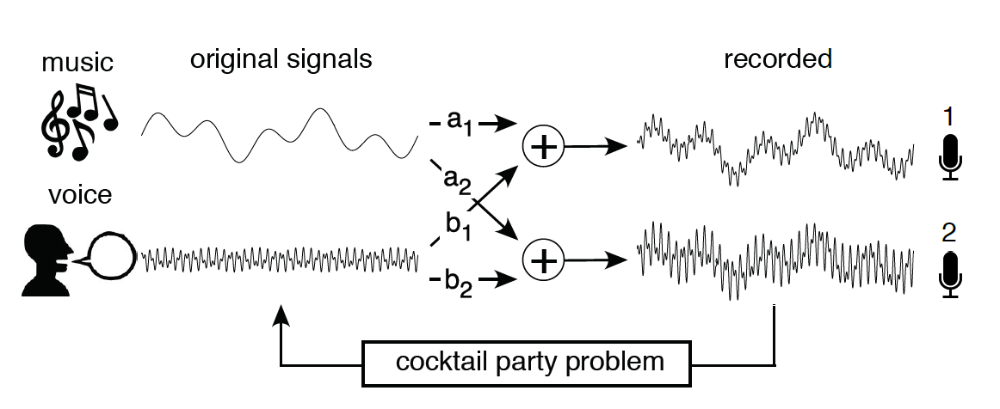

To test the goodness of my implementation, I have tried to apply it to a simple example of a cocktail party problem, following the example of present in the scikit library's documentation.

In this example, three source signals are generated: a *sinusoidal signal*, a *sqaure wave pulse* and a *sawtooth signal*.

The three original signals are then mixed with a random mixing matrix $A$ to generate the observations $X$. Finally both sklearn implementation of FastICA and mine are used to recover the original source signals

In [146]:
import IPython.display as ipd
from scipy.io.wavfile import read

AUDIO_NAME = ['train', 'laugh', 'gong']

fig = make_subplots(rows=3, cols=1)

S = []
for i,audio in enumerate(['audio/original_train.wav', 'audio/original_laughter.wav', 'audio/original_gong.wav']):
    x = read(audio)
    S.append(x[1])
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(len(x[1])), y = x[1], name=AUDIO_NAME[i]), col=1, row=i+1)
S =np.array(S)
fig.update_layout(title='Original audio sources')
fig.show()

for i,s in enumerate(S):
    print(f'ORIGINAL: {AUDIO_NAME[i]}')
    ipd.display(ipd.Audio(s, rate=x[0]))

ORIGINAL: train


ORIGINAL: laugh


ORIGINAL: gong


In [147]:
import numpy as np
A = rng.random(size=(3,3))
X = np.dot(A, S) 

fig = make_subplots(rows=3, cols=1)
for i,mix in enumerate(X):
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(len(mix)), y = mix, name=f'mix-{i}'), col=1, row=i+1)
    
fig.update_layout(title='Mixed signals (microphones)')
fig.show()

for i,s in enumerate(X):
    print(f'MICROPHONE: {i+1}')
    ipd.display(ipd.Audio(s, rate=x[0]))

MICROPHONE: 1


MICROPHONE: 2


MICROPHONE: 3


In [148]:
myica = myFast_ICA(n_components=3, rng=rng)
myica_S = myica.fit_transform(X.T)

fig = make_subplots(rows=3, cols=1)
for i in range(myica_S.shape[1]):
    fig.add_trace(go.Scatter(mode='lines',x=np.arange(myica_S.shape[0]), y = myica_S[:,i], name=f'reconstructed-{i}'), col=1, row=i+1)
    
fig.update_layout(title='Reconstructed signals (myICA)')
fig.show()

for i in range(myica_S.shape[1]):
    print(f'RECONSTRUCTED: {i+1}')
    ipd.display(ipd.Audio(myica_S[:,i], rate=x[0]))


RECONSTRUCTED: 1


RECONSTRUCTED: 2


RECONSTRUCTED: 3


Note that on a real application, the only thing we have are the signals in the right part of the plot, and from these we want to retrieve the source signals on the left. As we can see even from this simple example, this is not at all a trivial problem. Looking at the picture, for example we can spot un underlying sawtooth signal and maybe also the square signal. However, is very difficult to spot an underlying sinusoidal signal.


Typical application of ICA includes the analysis of photographic images, medical signals (EEG, MEG, MRI), biological assays and obviously audio signal procesing.

But that's not the only application. Consider a classical feature space, ICA aims to find the directions in this space, whose projections have the highest-non-gaussianity. Differently from PCA, ICA is not restricted to an orthogonal basis in the original feature space, because statistical independence makes no such requirement. However, these directions are orthogonal in the whitened feature space These directions does not need to be orthogonal.

This behavior of ICA...

In [2]:
from IPython.core.display import display, HTML
display(HTML(
    '<style>'
        '#notebook { padding-top:0px !important; } ' 
        '.container { width:60% !important; } '
        '.end_space { min-height:0px !important; } '
    '</style>'
))

In [115]:
from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: right;
    vertical-align: middle;
}
</style>
""")

### Squared cosine

Consider the triangle composed by the origin, an observation and its projection along a component $k$. Considering that the dataset is zero-centered, the squared distance between the point and the origin is $d_{i,g}^2 = \sum_{k}f_{i,k}^2$ and the sqaured distance between the origin and the projection is given by the corresponding score $f_{i,k}^2$. The squared cosine is simply the ratio between the two:

$$ \cos_{i,k}^2 = \frac{f_{i,k}^2}{\sum_{k}f_{i,k}^2} $$

> The squared cosine quantifies the importance of a component to an observation, in particular it indicates the contribution of a component to the squared distance of the observation to the origin

Components with a large $\cos_{i,k}^2$ are the ones that contributes the most to the distance of the point $i$ to the origin, and so are the most important for that observation. On the contrary, components with low $\cos_{i,k}^2$ are irrelevant

> Squared cosine can help find the components that are important to interpret both active and supplementary observations


In [ ]:
def squared_cosine(X, pca, k):
    f = pca.transform(X) **2
    return f[:,k] / f.sum(axis = 1)

squared_cosine(X, pca, 1)